<a href="https://colab.research.google.com/github/LilBazil/dino-pic-recognition/blob/main/DinoRecognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Подготовка


Подключение Google Drive к Colab для доступа к папкам и изображениям датасета

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Обновление fastai

In [ ]:
!pip install --upgrade fastai

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21

Импорт библеотек, модулей и настройка вывода графиков

In [ ]:
import os
from fastai.vision import *
from fastai.metrics import error_rate
from keras.preprocessing.image import ImageDataGenerator
from fastai.vision.data import ImageDataLoaders
from fastai.vision.all import *
import pandas as pd
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt
import socket,warnings
from fastai.vision.widgets import *
import pickle

%reload_ext autoreload
%autoreload 2
%matplotlib inline

Установка переменных

In [ ]:
bs = 64
sz = 256
PATH = '/content/drive/MyDrive/нейронка3/dinosaur_dataset'
path = Path('/content/drive/MyDrive/нейронка3/dinosaur_dataset')

Определение классов в датасете

In [ ]:
classes = []
for d in os.listdir(PATH):
    if os.path.isdir(os.path.join(PATH, d)) and not d.startswith('.'):
        classes.append(d)
print ("Обнаружено классов: ", len(classes), "\n", classes)

Обнаружено классов:  15 
 ['Dilophosaurus', 'Microceratus', 'Ankylosaurus', 'Compsognathus', 'Brachiosaurus', 'Gallimimus', 'Corythosaurus', 'Dimorphodon', 'Pachycephalosaurus', 'Tyrannosaurus_Rex', 'Stegosaurus', 'Velociraptor', 'Parasaurolophus', 'Triceratops', 'Spinosaurus']


In [ ]:
data = ImageDataLoaders.from_folder(PATH, valid_pct=0.2, item_tfms=Resize(sz))
print ("\nОбучающие     ", len(data.train_ds), "\nВалидационные ", len(data.valid_ds))


Обучающие      2160 
Валидационные  539


Определение функций:
* проверки открытия изображения
* получения названия вида

In [ ]:
def can_open_image(fn):
    try:
        img = Image.open(fn)
        return True
    except:
        return False

def get_species(fn):
    return parent_label(fn)

# Осмотр датасета

Отображение графика с выводом 5 названий и изображений вида динозавра

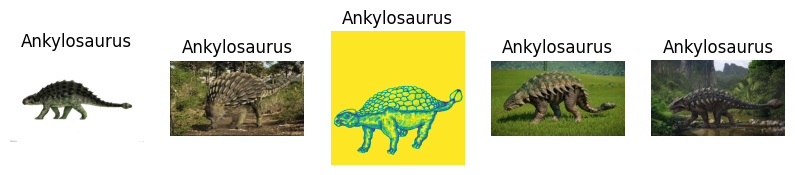

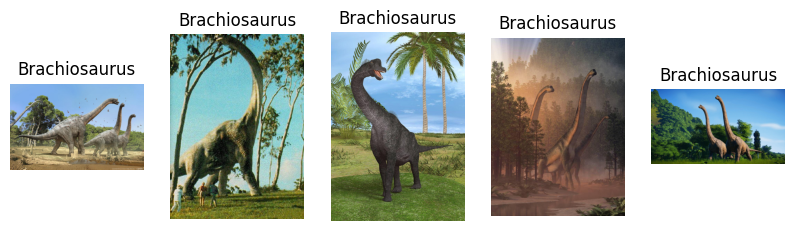

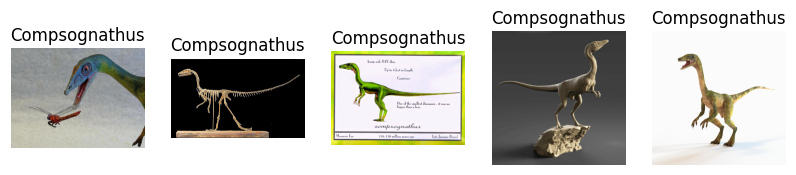

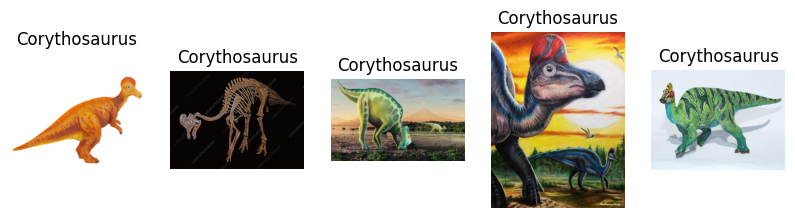

<Figure size 1000x500 with 0 Axes>

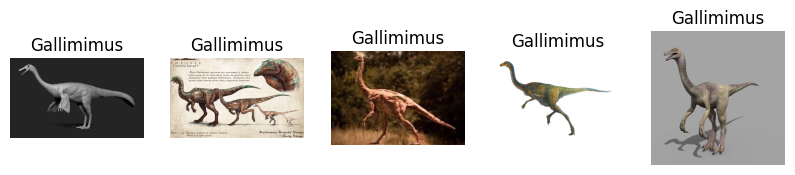

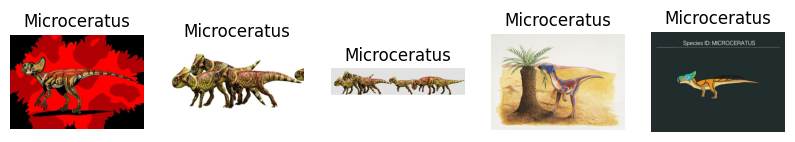

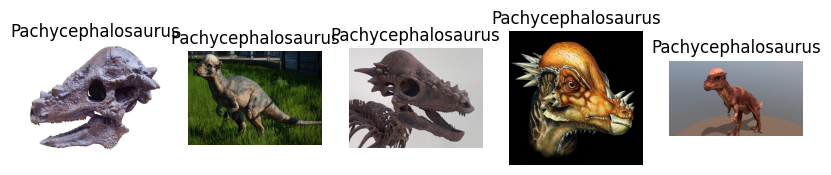

<Figure size 1000x500 with 0 Axes>

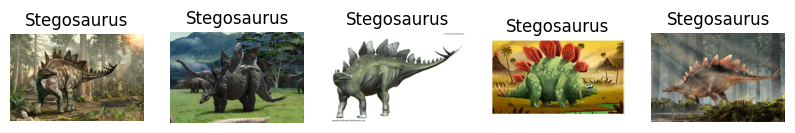

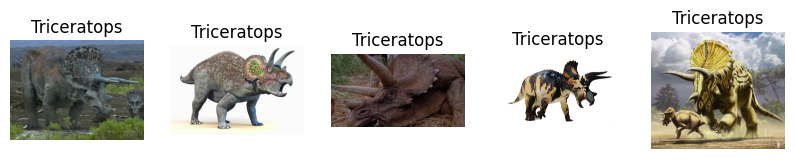

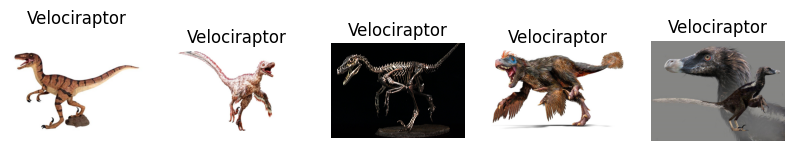

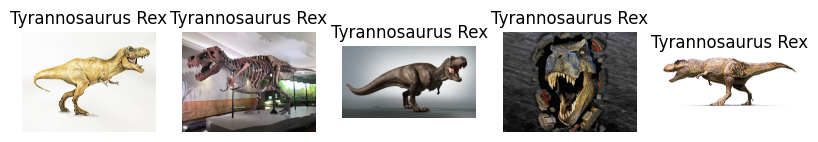

In [ ]:
selected_species = [
    "Ankylosaurus", "Brachiosaurus", "Compsognathus", "Corythosaurus", "Dilophosaurus"
    "Dimorphodon", "Gallimimus", "Microceratus", "Pachycephalosaurus", "Parasaurolophus"
    "Spinosaurus", "Stegosaurus", "Triceratops", "Velociraptor", "Tyrannosaurus Rex"
]

for species in selected_species:
    species_path = path / species.replace(" ", "_")
    image_files = list(species_path.glob('*.jpg'))[:5]
    plt.figure(figsize=(10, 5))

    for i, img_path in enumerate(image_files, 1):
        try:
            img = Image.open(img_path)
            plt.subplot(1, 5, i)
            plt.imshow(img)
            plt.axis('off')
            plt.title(species.replace('_', ' '))
        except Exception as e:
            print(f"Не получается открыть изображение: {img_path}: {e}")
    plt.show()

all_images = get_image_files(path, recurse=True).filter(can_open_image)
df = pd.DataFrame({'image': all_images, 'виды': [get_species(fn) for fn in all_images]})
min_count = df['виды'].value_counts().min()
balanced_df = df.groupby('виды').sample(n=min_count, replace=False, random_state=42)

Балансировка датасета

+
функция получения сбалансированных изображений из датасета

In [ ]:

def get_balanced_image_files(path):
    return balanced_df['image'].values

balanced_files = get_balanced_image_files(path)
print(f"Количество изображений в датасете: {len(balanced_files)}")

Количество изображений в датасете: 2685


# Обучение

Определение структуры данных для загрузки и обработки изображений

In [ ]:
if len(balanced_files) > 0:
    dls = DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_items=get_balanced_image_files,
        splitter=RandomSplitter(valid_pct=0.25, seed=42),
        get_y=parent_label,
        item_tfms=Resize(512),
        batch_tfms=[*aug_transforms(size=250, min_scale=0.75), Normalize.from_stats(*imagenet_stats)]
    ).dataloaders(path, bs=64)

Создание модели обучения

+

График для поиска оптимальной скорости обучения



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


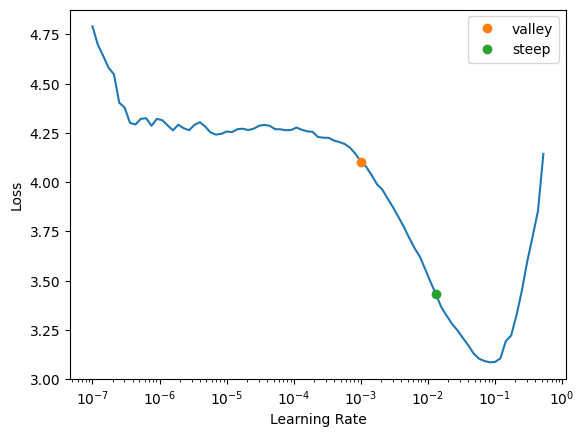

In [ ]:
    learn = vision_learner(dls, resnet34, metrics=error_rate)
    lr_min, lr_steep = learn.lr_find(suggest_funcs=(valley, steep))

Донастройка модели

+

вывод матрицы ошибок

epoch,train_loss,valid_loss,error_rate,time
0,0.233743,0.527853,0.144560,01:31


Better model found at epoch 0 with valid_loss value: 0.5278528332710266.


epoch,train_loss,valid_loss,error_rate,time
0,0.257327,0.509219,0.143070,01:31
1,0.222427,0.523097,0.144560,01:32
2,0.208600,0.521724,0.141580,01:29
3,0.215493,0.537593,0.150522,01:34
4,0.197053,0.505415,0.135618,01:30
5,0.169303,0.540852,0.146051,01:30
6,0.147024,0.518056,0.150522,01:28
7,0.123312,0.508227,0.140089,01:32
8,0.108210,0.500463,0.141580,01:29
9,0.100642,0.499488,0.144560,01:30


Better model found at epoch 0 with valid_loss value: 0.5092185735702515.
Better model found at epoch 4 with valid_loss value: 0.505414605140686.
Better model found at epoch 8 with valid_loss value: 0.5004632472991943.
Better model found at epoch 9 with valid_loss value: 0.49948805570602417.
Better model found at epoch 10 with valid_loss value: 0.4982083737850189.
Better model found at epoch 11 with valid_loss value: 0.49191612005233765.


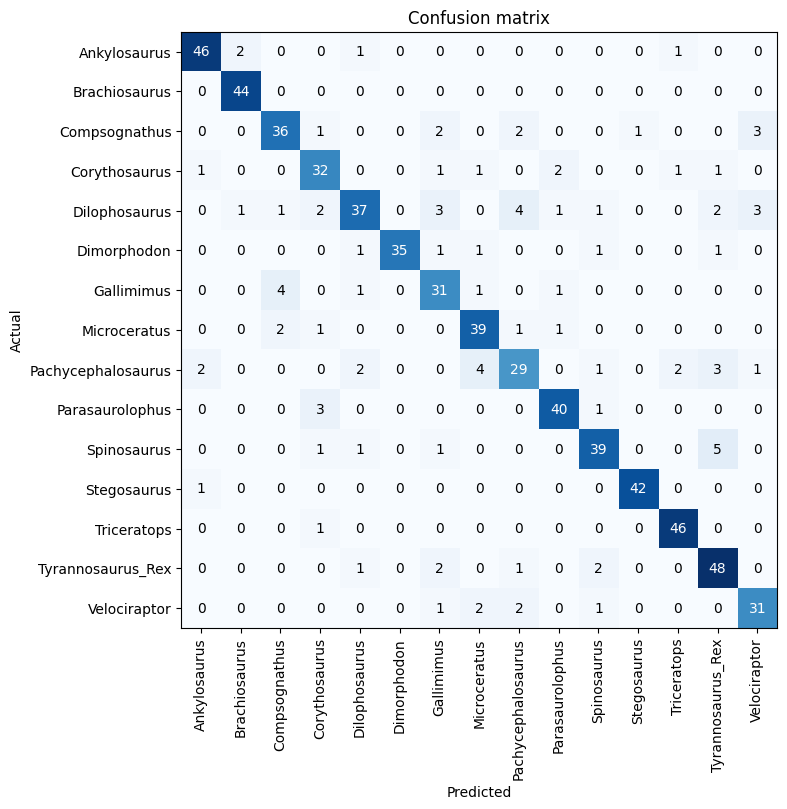

In [ ]:
    try:
        epoch = 12
        learn.fine_tune(epoch, base_lr=lr_min, cbs=[SaveModelCallback()])
    except Exception as e:
        print(f"Ошибка настройки: {e}")

    interp = ClassificationInterpretation.from_learner(learn)
    interp.plot_confusion_matrix(figsize=(8, 8))

# Работа с моделью

In [ ]:
from fastai.vision.all import *
from fastai.vision.widgets import *
cleaner = ImageClassifierCleaner(learn)
cleaner

Удаление изображения

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

Перемещение изображения

In [ ]:
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

Сохранить модель

In [ ]:
learn.save('dino_model')

Path('models/dino_model.pth')

In [ ]:
with open('dino_model.pkl', 'wb') as f:
    pickle.dump(learn, f)

Загрузить модель

In [ ]:
learn = load_learner('/content/dino_model.pkl')

FileNotFoundError: [Errno 2] No such file or directory: '/content/dino_model.pkl'

Микротест

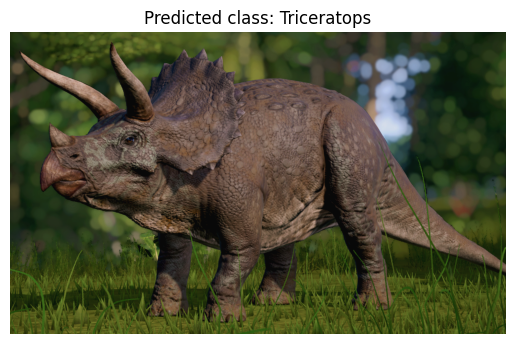

In [ ]:
preds = learn.predict('/content/drive/MyDrive/нейронка3/test_trice1.png')
img = Image.open('/content/drive/MyDrive/нейронка3/test_trice1.png')
plt.imshow(img)

plt.axis('off')
plt.title(f"Predicted class: {preds[0]}")
plt.show()

# ТГ бот

In [ ]:
!pip uninstall python-telegram-bot
!pip install python-telegram-bot

Found existing installation: python-telegram-bot 21.2
Uninstalling python-telegram-bot-21.2:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/python_telegram_bot-21.2.dist-info/*
    /usr/local/lib/python3.10/dist-packages/telegram/*
Proceed (Y/n)? y
  Successfully uninstalled python-telegram-bot-21.2
  Using cached python_telegram_bot-21.2-py3-none-any.whl (629 kB)


In [ ]:
import telegram
from telegram.ext import Updater, CommandHandler, MessageHandler, Filters
from PIL import Image

ImportError: cannot import name 'Filters' from 'telegram.ext' (/usr/local/lib/python3.10/dist-packages/telegram/ext/__init__.py)